1. Import bibliotek
2. Załadowanie danych 
3. Przygotowanie zbiorów: Treningowy, testowy i walidacyjny
4. Eksploracja danych 
5. Augmentacja danych
6. Budowa modelu
7. Transfer learning - model VGG 16
8. Transfer learning - model VGG 16 odmrożenie kilku ostatnich wartstw
9. Ocena modelu na zbiorze testowym
10. Wyświetlenie błędów predykcji


In [50]:
import os 
import shutil
import numpy as np 
import matplotlib.pyplot as plt
import seaborn as sns
sns.set()
import warnings
warnings.filterwarnings('ignore')
from keras.preprocessing import image
from keras.preprocessing.image import ImageDataGenerator
from keras import utils, layers, models, optimizers
import time
import keras.backend as K
import cv2 
import sys
import PIL 
from PIL import Image
from keras.applications.vgg16 import VGG16, preprocess_input
import tensorflow as tf
tf.compat.v1.disable_eager_execution()

In [51]:
base_dir = '../Projekt DL/PetImages'
cat_dir = '../Projekt DL/PetImages/Cat'
dog_dir = '../Projekt DL/PetImages/Dog'
if not os.path.exists(base_dir):
  os.mkdir(base_dir)

train_dir = os.path.join(base_dir, 'train')
test_dir = os.path.join(base_dir, 'test')
val_dir = os.path.join(base_dir, 'val')

for directory in (train_dir, val_dir, test_dir):
  if not os.path.exists(directory):
    os.mkdir(directory)

train_cats_dir = os.path.join(train_dir, 'cats')
train_dogs_dir = os.path.join(train_dir, 'dogs')

test_cats_dir = os.path.join(test_dir, 'cats')
test_dogs_dir = os.path.join(test_dir, 'dogs')

val_cats_dir = os.path.join(val_dir, 'cats')
val_dogs_dir = os.path.join(val_dir, 'dogs')

dirs= [train_cats_dir, train_dogs_dir, val_cats_dir, val_dogs_dir, test_cats_dir, test_dogs_dir]

for directory in dirs: 
  if not os.path.exists(directory):
    os.mkdir(directory)

In [89]:
zdjc= cv2.imread(base_dir + '/' + 'dog/' + '500.jpg') # Sprowadzić zdjęcia do kwadratu 

(328, 500, 3)

In [3]:
# fnames =['{}.jpg'.format(i) for i in range(8000)]
# for fname in fnames:
#   src = os.path.join(cat_dir, fname)
#   dst = os.path.join(train_cats_dir, fname)
#   shutil.copyfile(src, dst)

# fnames =['{}.jpg'.format(i) for i in range(8000,10000)]
# for fname in fnames:
#   src = os.path.join(cat_dir, fname)
#   dst = os.path.join(test_cats_dir, fname)
#   shutil.copyfile(src, dst)

# fnames =['{}.jpg'.format(i) for i in range(10000,12500)]
# for fname in fnames:
#   src = os.path.join(cat_dir, fname)
#   dst = os.path.join(val_cats_dir, fname)
#   shutil.copyfile(src, dst)

# fnames =['{}.jpg'.format(i) for i in range(8000)]
# for fname in fnames:
#   src = os.path.join(dog_dir, fname)
#   dst = os.path.join(train_dogs_dir, fname)
#   shutil.copyfile(src, dst)

# fnames =['{}.jpg'.format(i) for i in range(8000,10000)]
# for fname in fnames:
#   src = os.path.join(dog_dir, fname)
#   dst = os.path.join(test_dogs_dir, fname)
#   shutil.copyfile(src, dst)

# fnames =['{}.jpg'.format(i) for i in range(10000,12500)]
# for fname in fnames:
#   src = os.path.join(dog_dir, fname)
#   dst = os.path.join(val_dogs_dir, fname)
#   shutil.copyfile(src, dst)

In [4]:
from google.colab import drive
drive.mount('/content/drive')

ModuleNotFoundError: No module named 'google.colab'

In [52]:
def accuracy_plot(model_res):

  acc, val_acc = model_res.history['accuracy'], model_res.history['val_accuracy']
  epoki = range(1, len(acc) + 1 )

  plt.figure(figsize= (12,12))
  plt.plot(epoki, acc, label='Accuracy', marker= 'o' )
  plt.plot(epoki, val_acc, label='Val_Accuracy', marker= 'o' )
  plt.legend()
  plt.title('Wykres accuracy dla zbioru treningowego i walidacyjnego')
  plt.xlabel('Epoka')
  plt.ylabel('Accuracy')
  plt.show()

def loss_plot(model_res):
  
  loss, val_loss = model_res.history['loss'], model_res.history['val_loss']
  epoki = range(1, len(loss) + 1 )

  plt.figure(figsize= (12,12))
  plt.plot(epoki, loss, label='Loss', marker= 'o' )
  plt.plot(epoki, val_loss, label='Val_Loss', marker= 'o' )
  plt.legend()
  plt.title('Wykres straty dla zbioru treningowego i walidacyjnego')
  plt.xlabel('Epoka')
  plt.ylabel('Loss')
  plt.show()

def show_aug_img(dir, index):

  fnames= [os.path.join(dir, fname) for fname in os.listdir(dir)]
  img_path = fnames[index]
  img = utils.load_img(img_path, target_size = (150,150))

  x = utils.img_to_array(img)
  x = x.reshape((1, ) + x.shape)

  plt.figure(figsize= (24,24))
  licznik = 1 
  for batch in datagen.flow(x, batch_size = 1):
    plt.subplot(3, 4, licznik)
    plt.grid(False)
    imgplot = plt.imshow(utils.array_to_img(batch[0]))
    licznik += 1 
    if licznik % 13 == 0:
      break

(-0.5, 425.5, 319.5, -0.5)

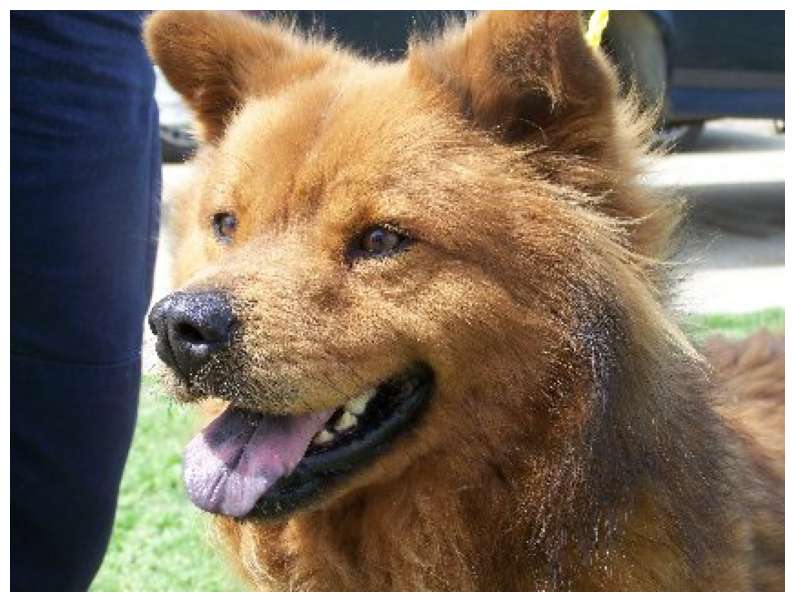

In [53]:
#@markdown Wybierz zdjęcie psa:

index = 45 #@param {type:'slider' ,min:0, max:999}
img_path = dog_dir + '/' + str(index) + '.jpg'

img = utils.load_img(img_path) 

plt.figure(figsize = (10,10))
plt.imshow(img)
plt.grid(False)
plt.axis(False)

In [77]:
img.shape

AttributeError: shape

## Wyostrzenie krawędzi 


(-0.5, 499.5, 475.5, -0.5)

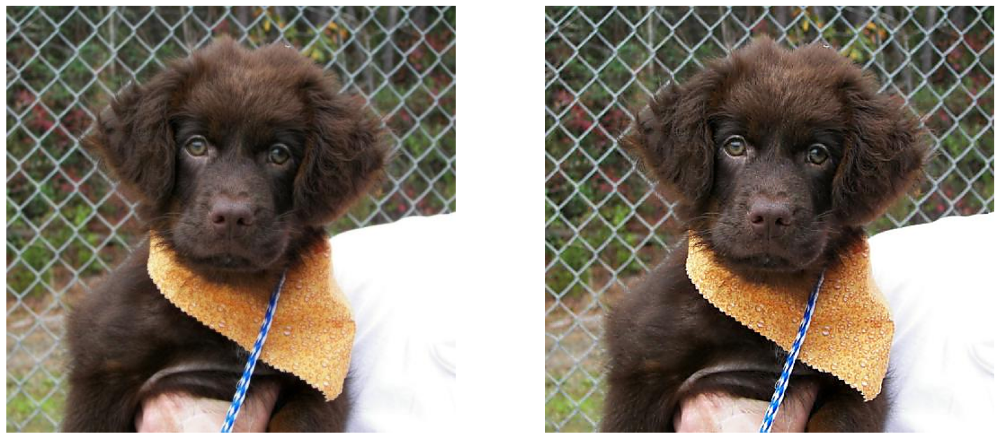

In [ ]:
zdjecie = PIL.Image.open(dog_dir +'/' + os.listdir(dog_dir + '/')[46])
wyostrzone_zdjecie = zdjecie.filter(PIL.ImageFilter.UnsharpMask(radius=1, percent=140))
fig = plt.figure(1, figsize = (20, 20))
plt.subplot(2,2,1)
plt.imshow(zdjecie)
plt.axis(False)
plt.subplot(2,2,2)
plt.imshow(wyostrzone_zdjecie)
plt.axis(False) 

In [6]:
# for i in tqdm(range(len(os.listdir(filepath)))):
#         pic_path = filepath + os.listdir(filepath)[i]
#         pic = PIL.Image.open(pic_path)
#         pic_sharp = pic.filter(PIL.ImageFilter.UnsharpMask(radius=2, percent=110))
#         pic_sharp.save(pic_path)

NameError: name 'tqdm' is not defined

In [26]:
datagen = ImageDataGenerator(rotation_range = 30,
                             brightness_range= (0.3,1),
                             width_shift_range = 0.2,
                             shear_range = 0.2,
                             height_shift_range = 0.2,
                             zoom_range = 1,
                            )

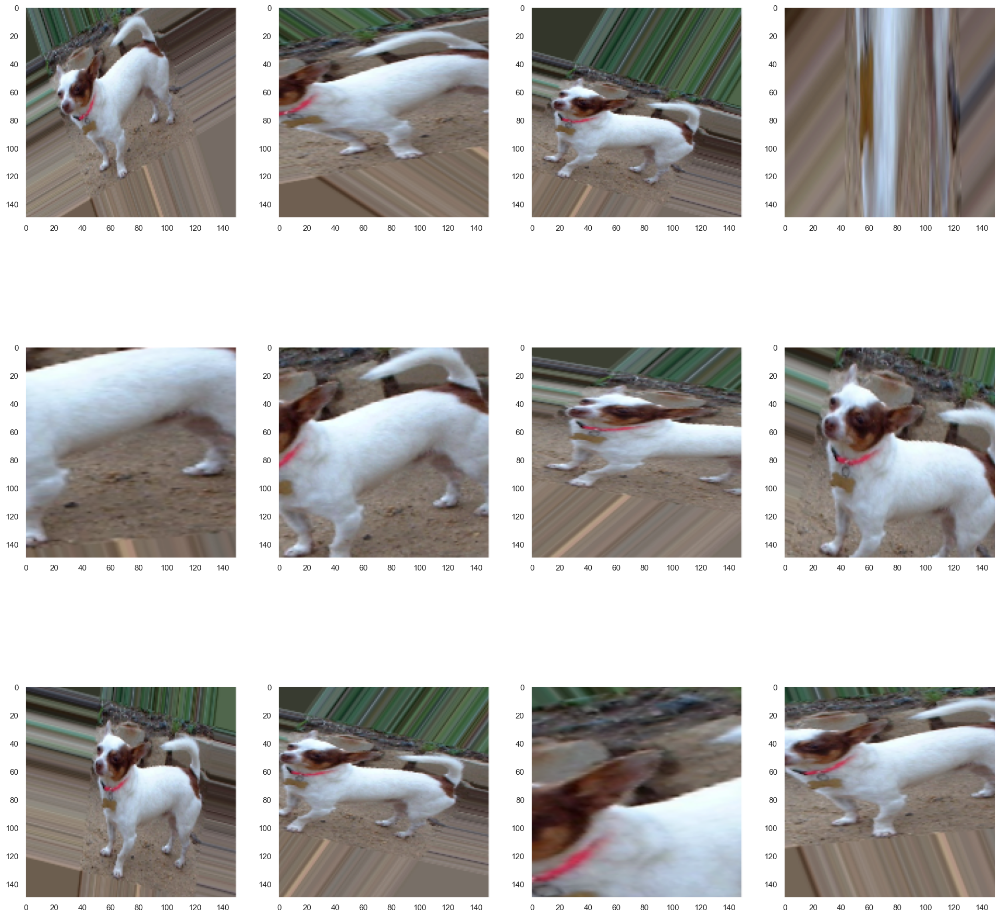

In [27]:
index = 105
show_aug_img(train_dogs_dir, index)

In [55]:
model = models.Sequential()
model.add(layers.Conv2D(filters = 32, kernel_size = (3,3) , activation = 'relu', input_shape=(150,150,3)))
model.add(layers.MaxPooling2D(pool_size = (2,2)))
# model.add(layers.BatchNormalization())
model.add(layers.Conv2D(filters = 64, kernel_size = (3,3), activation = 'relu'))
model.add(layers.MaxPooling2D(pool_size = (2,2)))
# model.add(layers.BatchNormalization())
model.add(layers.Conv2D(filters = 128, kernel_size = (3,3), activation = 'relu'))
model.add(layers.MaxPooling2D(pool_size = (2,2)))
# model.add(layers.BatchNormalization())
model.add(layers.Conv2D(filters = 128, kernel_size = (3,3), activation = 'relu'))
model.add(layers.MaxPooling2D(pool_size = (2,2)))
# model.add(layers.BatchNormalization())
model.add(layers.MaxPooling2D(pool_size = (2,2)))
model.add(layers.Flatten())
model.add(layers.Dropout(0.5))
model.add(layers.Dense(units = 512, activation = 'relu'))
# model.add(layers.Dense(units = 256, activation = 'relu'))
# model.add(layers.Dense(units = 256, activation = 'relu'))
model.add(layers.Dense(units = 1, activation = 'sigmoid'))
model.summary()


Model: "sequential_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_26 (Conv2D)          (None, 148, 148, 32)      896       
                                                                 
 max_pooling2d_21 (MaxPoolin  (None, 74, 74, 32)       0         
 g2D)                                                            
                                                                 
 conv2d_27 (Conv2D)          (None, 72, 72, 64)        18496     
                                                                 
 max_pooling2d_22 (MaxPoolin  (None, 36, 36, 64)       0         
 g2D)                                                            
                                                                 
 conv2d_28 (Conv2D)          (None, 34, 34, 128)       73856     
                                                                 
 max_pooling2d_23 (MaxPoolin  (None, 17, 17, 128)     

In [56]:
model.compile(optimizer ='adam', 
              loss = 'binary_crossentropy',
              metrics = ['accuracy'])

In [57]:


val_gen = ImageDataGenerator(rescale = 1./255.)

vtre_gen = ImageDataGenerator(rotation_range = 40,
                             width_shift_range = 0.2,
                             height_shift_range = 0.2,
                             shear_range= 0.2,
                             zoom_range = 0.2,
                             horizontal_flip=True,
                             rescale = 1./255.)

train_generator = vtre_gen.flow_from_directory(directory = train_dir,
                                                target_size = (150,150),
                                                batch_size = 32, 
                                                class_mode ='binary')
val_generator = val_gen.flow_from_directory(directory = val_dir,
                                              target_size = (150,150),
                                              batch_size = 32, 
                                              class_mode ='binary')

Found 15995 images belonging to 2 classes.
Found 4998 images belonging to 2 classes.


In [147]:
pocz = time.time()
model_res = model.fit_generator(generator=train_generator, 
                                steps_per_epoch = 100,
                                epochs =  15,
                                validation_data = val_generator, 
                                validation_steps=50,
                                verbose=2)
koniec = time.time()
print('Czas uczenia się modelu: {}'.format(koniec - pocz))


Epoch 1/15
100/100 - 76s - loss: 0.4629 - accuracy: 0.7844 - val_loss: 0.4372 - val_accuracy: 0.8025 - 76s/epoch - 759ms/step
Epoch 2/15
100/100 - 75s - loss: 0.4434 - accuracy: 0.7919 - val_loss: 0.3995 - val_accuracy: 0.8050 - 75s/epoch - 747ms/step
Epoch 3/15
100/100 - 76s - loss: 0.4539 - accuracy: 0.7812 - val_loss: 0.4264 - val_accuracy: 0.7987 - 76s/epoch - 758ms/step
Epoch 4/15
100/100 - 78s - loss: 0.4741 - accuracy: 0.7688 - val_loss: 0.4371 - val_accuracy: 0.8062 - 78s/epoch - 779ms/step
Epoch 5/15
100/100 - 79s - loss: 0.4525 - accuracy: 0.7862 - val_loss: 0.4170 - val_accuracy: 0.8069 - 79s/epoch - 785ms/step
Epoch 6/15
100/100 - 75s - loss: 0.4466 - accuracy: 0.7894 - val_loss: 0.4007 - val_accuracy: 0.8050 - 75s/epoch - 752ms/step
Epoch 7/15
100/100 - 69s - loss: 0.4420 - accuracy: 0.7962 - val_loss: 0.4148 - val_accuracy: 0.8025 - 69s/epoch - 690ms/step
Epoch 8/15
100/100 - 70s - loss: 0.4486 - accuracy: 0.7928 - val_loss: 0.4275 - val_accuracy: 0.8019 - 70s/epoch - 703

In [148]:
model_res.history['accuracy'], model_res.history['val_accuracy']

([0.784375011920929,
  0.7918750047683716,
  0.7812206745147705,
  0.768750011920929,
  0.7862499952316284,
  0.7893750071525574,
  0.7962499856948853,
  0.7928125262260437,
  0.7902973294258118,
  0.7940624952316284,
  0.7809374928474426,
  0.7865625023841858,
  0.8040624856948853,
  0.8053125143051147,
  0.8068857789039612],
 [0.8025000095367432,
  0.8050000071525574,
  0.7987499833106995,
  0.8062499761581421,
  0.8068749904632568,
  0.8050000071525574,
  0.8025000095367432,
  0.8018749952316284,
  0.8199999928474426,
  0.8081250190734863,
  0.815625011920929,
  0.8206250071525574,
  0.809374988079071,
  0.8218749761581421,
  0.8137500286102295])

In [ ]:
x = model_res.history['accuracy']

[0.5266666412353516,
 0.5143333077430725,
 0.5256666541099548,
 0.5643697381019592,
 0.5600000023841858,
 0.5609999895095825,
 0.5766666531562805,
 0.5699999928474426,
 0.5596638917922974,
 0.5879999995231628,
 0.5856666564941406,
 0.5913333296775818]

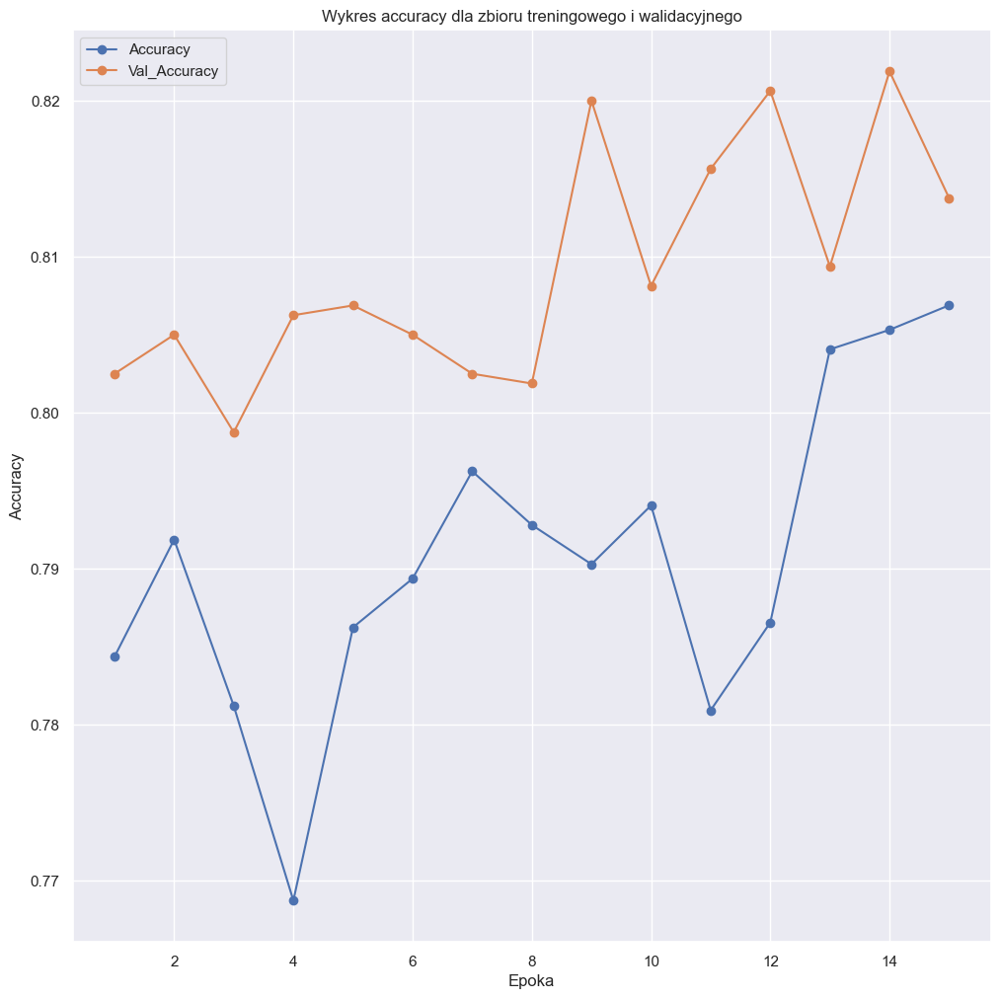

In [149]:
accuracy_plot(model_res)

In [61]:
lossmod, val_lossmod = model_res.history['loss'], model_res.history['val_loss']

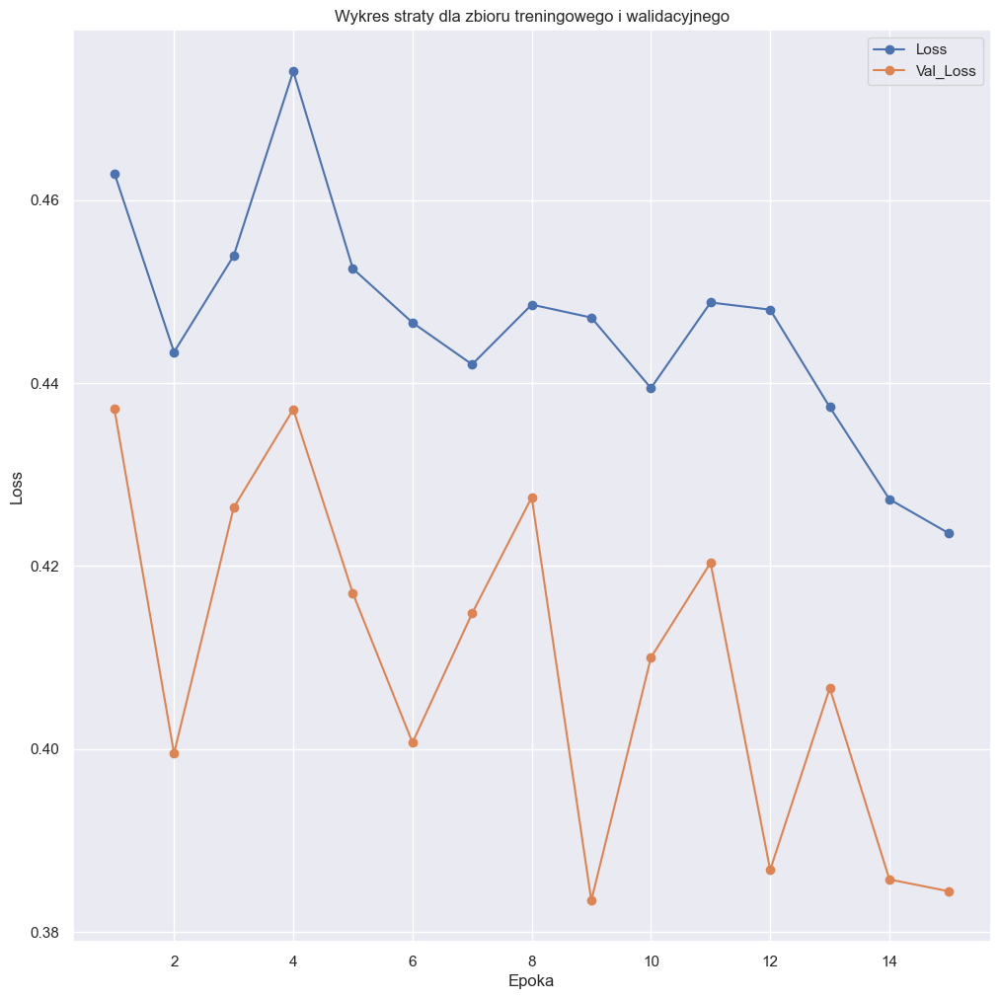

In [150]:
loss_plot(model_res)

In [ ]:
model.save('koty_i_psy.h5')

##Ocena Cech


(-0.5, 149.5, 149.5, -0.5)

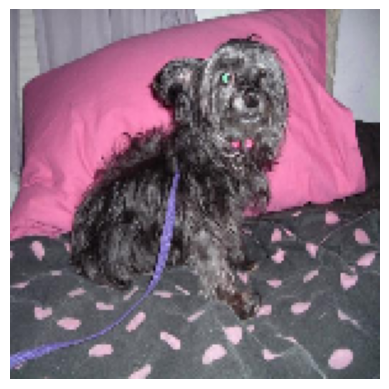

In [90]:
#@markdown Wybierz zdjęcie psa:

index3 = 0 #@param {type:'slider' ,min:0, max:999}
img_path = base_dir + '/dog/' + str(index3) + '.jpg'

img = utils.load_img(img_path, target_size = (150,150))
img_tensor = utils.img_to_array(img)
img_tensor = np.expand_dims(img_tensor, axis = 0)
img_tensor /= 255.0

# print(img.tensor.shape)
plt.imshow(img_tensor[0])
plt.grid(False)
plt.axis(False)

In [91]:
layer_outputs = [layer.output for layer in model.layers[:8]]
activation_model = models.Model(inputs = model.input, outputs = layer_outputs)
activations = activation_model.predict(img_tensor)

first_layer_activation = activations[0]


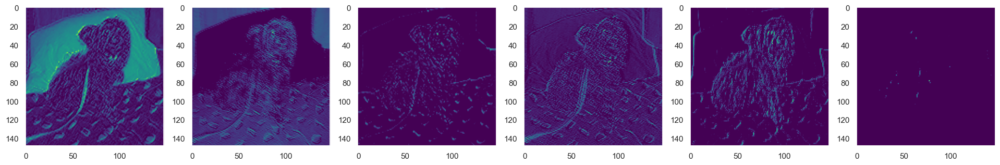

In [92]:
plt.figure(figsize = (23,23))

for i in range(1,7):
  plt.subplot(1,6,i)
  plt.imshow(first_layer_activation[0,:,:,i], cmap='viridis')
  plt.grid(False)

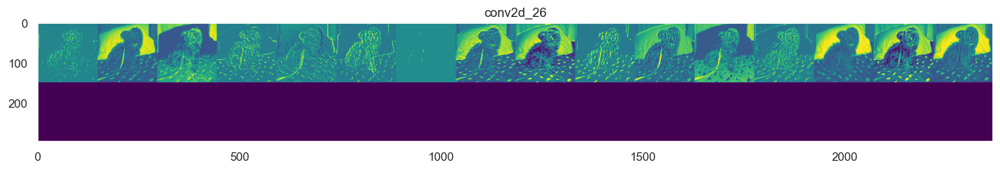

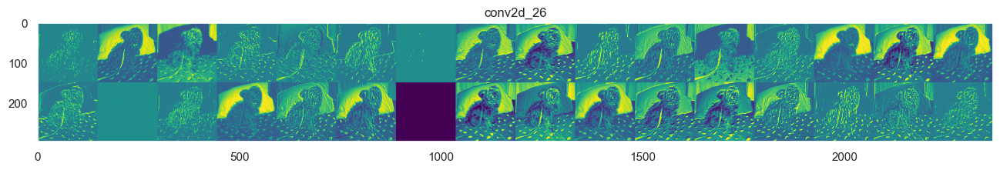

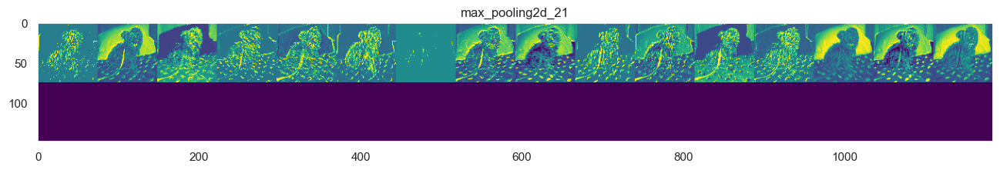

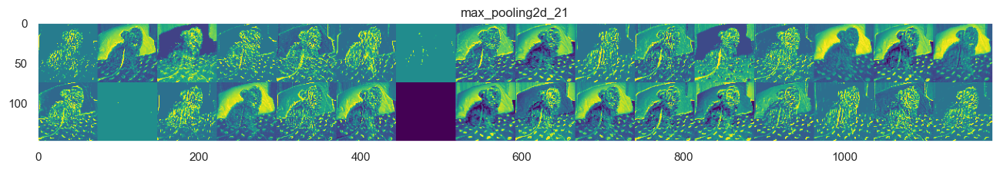

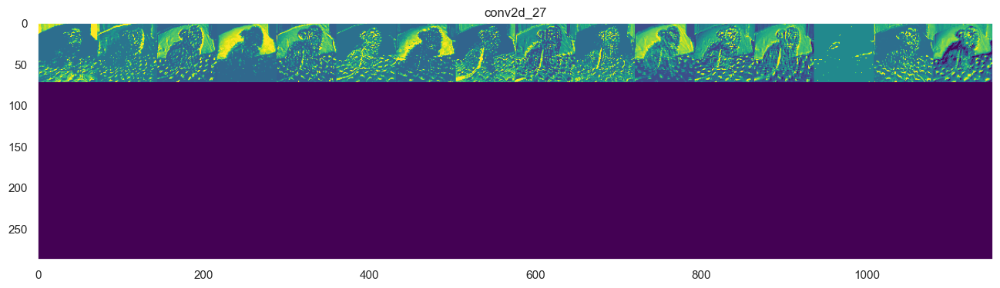

...

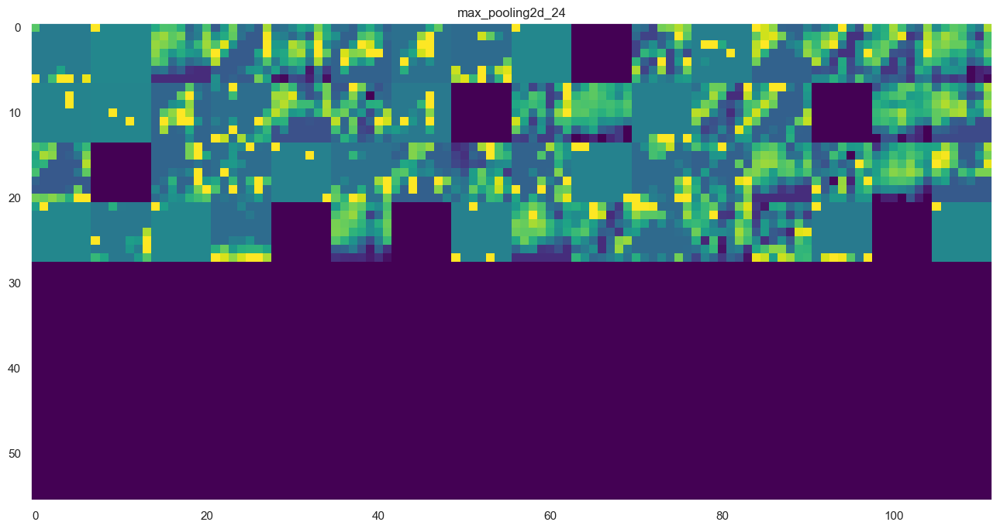

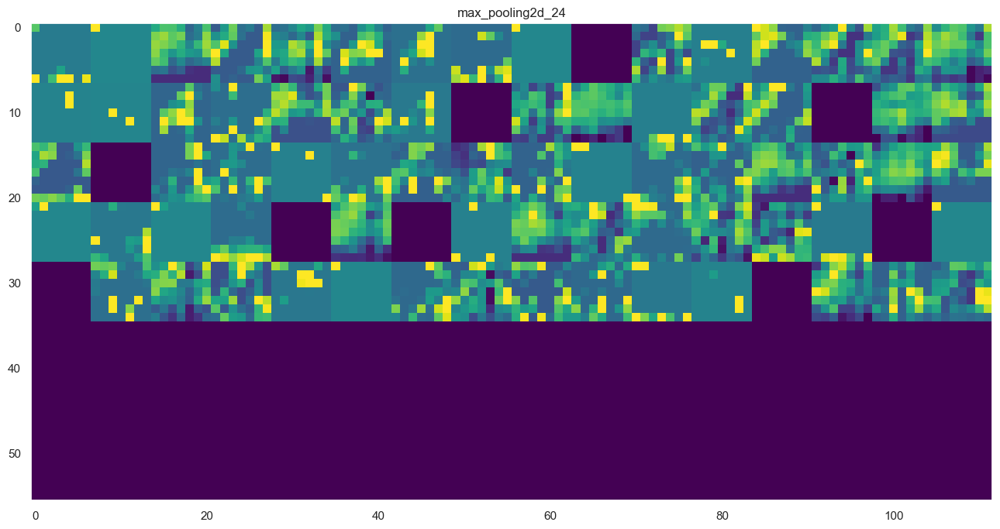

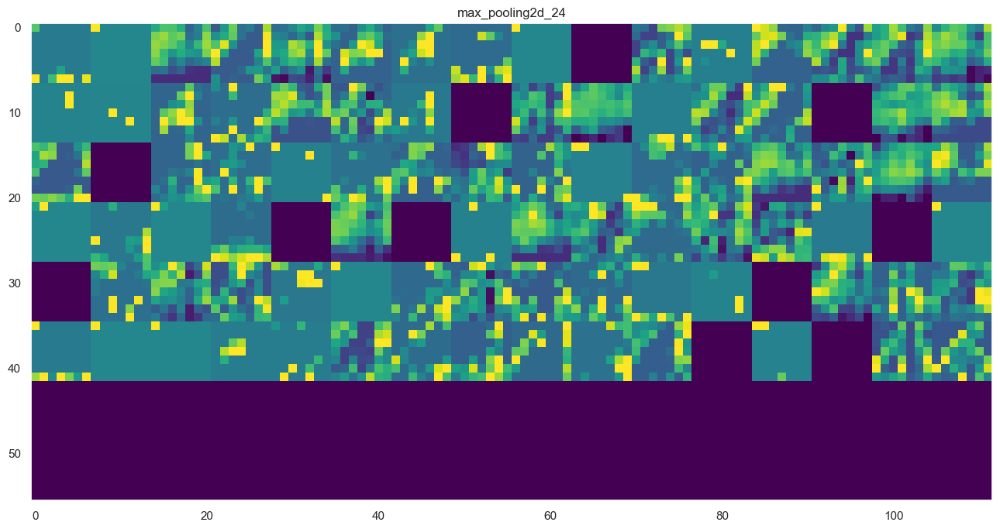

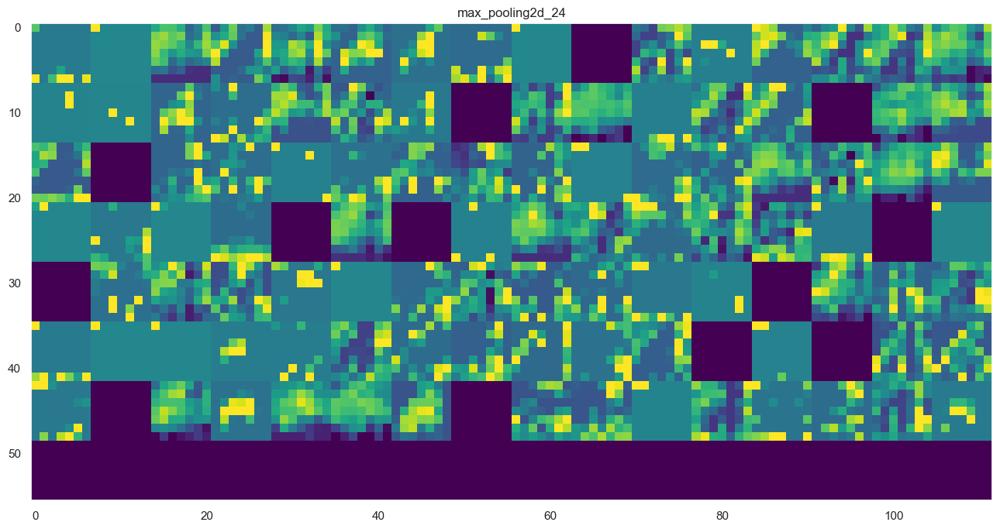

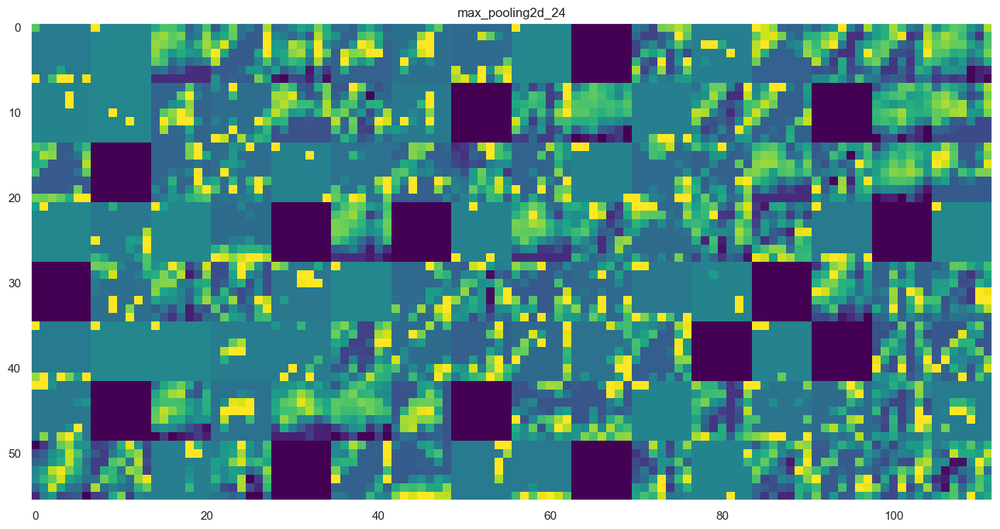

In [93]:
layer_names = [layer.name for layer in model.layers[:8]]

images_per_row = 16

for layer_name, layer_activation in zip(layer_names, activations):
  n_features = layer_activation.shape[-1]

  size = layer_activation.shape[1]

  n_cols = n_features // images_per_row

  display_grid = np.zeros((size *n_cols, images_per_row *size ))

  for col in range(n_cols):
    for row in range(images_per_row):
      channel_image = layer_activation[0,:,:,col * images_per_row + row]
      channel_image -= channel_image.mean()
      channel_image /= channel_image.std()
      channel_image *= 64
      channel_image += 128
      channel_image = np.clip(channel_image, 0 ,255).astype('uint8')
      display_grid[col * size: (col + 1) * size,row * size: ( row+ + 1) * size] = channel_image 

    scale = 1./size
    plt.figure(figsize = (scale * display_grid.shape[1], scale * display_grid.shape[0]))
    plt.title(layer_name)
    plt.grid(False)
    plt.imshow(display_grid, aspect = 'auto', cmap='viridis')

## FILTRY


In [ ]:
# #@markdown Wybierz warstwę filtru:
# layer = 'conv2D' #@param ['block4_conv1', 'block4_conv2', 'block5_conv1' ,'block5_conv2']
# plt.imshow(generate_pattern(layer, 1))
# plt.grid(False)

In [ ]:
last_layer_weights = model.layers[-1].get_weights()[0]
model2= keras.Model(inputs=model.input, 
        outputs=(model.layers[-4].output, model.layers[-1].output)) 
last_conv_output, pred_vec = model2.predict(preprocessed_img)
#Last conv. output for the image
last_conv_output = np.squeeze(last_conv_output) #7x7x2048
#Prediction for the image
pred = np.argmax(pred_vec)
# spline interpolation to resize each filtered image to size of original image 
h = int(img.shape[0]/last_conv_output.shape[0])
w = int(img.shape[1]/last_conv_output.shape[1])
upsampled_last_conv_output = scipy.ndimage.zoom(last_conv_output, (h, w, 1), order=1) # dim: 224 x 224 x 2048
last_layer_weights_for_pred = last_layer_weights[:, pred]
heat_map = np.dot(upsampled_last_conv_output.reshape((224*224, 2048)), 
                  last_layer_weights_for_pred).reshape(224,224) # dim: 224 x 224

##Wizualizacja map ciepła

Wizualizacja pozwala stwierdzić na podstawie której części obrazu model podjął decyzje o przypisaniu obrazu do klasy pies lub kot. Jest bardzo przydatną techniką do znajdowania i ewentualnego debugowania błędnie sklasyfikowanych obrazów. 

In [183]:
zwierzeta = 'Dog' #@param ['Cat', 'Dog']
numer_zdjecia = 1252 #@param {'type':'slider', min:0, max: 5000}

img_path = base_dir + '/Dog/' + str(index3) + '.jpg'
img = utils.load_img(img_path, target_size = (150, 150))
x = utils.img_to_array(img)
x = np.expand_dims(x, axis = 0)
x = preprocess_input(x)

preds = model.predict(x)
class_idx = np.argmax(preds[0])
class_output = model.output[:, class_idx]
last_conv_layer = model.get_layer('conv2d_29')

grads = K.gradients(class_output, last_conv_layer.output)[0]
# print(grads[0])
pooled_grads = K.mean(grads, axis= (0,1,2))
iterate = K.function([model.input], [pooled_grads, last_conv_layer.output])
pooled_grads_value, conv_layer_output_value = iterate([x])
# print(pooled_grads_value,conv_layer_output_value)


print(pooled_grads_value.shape)
for i in range(128):
  conv_layer_output_value[0,: ,:, i] *= pooled_grads_value[i]

print(conv_layer_output_value.shape)
heatmap= np.mean(conv_layer_output_value, axis = -1)
print(heatmap.shape)
heatmap = np.maximum(heatmap,0)
print(heatmap.shape)
heatmap /= np.max(heatmap)
print(heatmap.shape)
img = cv2.imread(img_path)
heatmap = cv2.resize(heatmap, (img.shape[1], img.shape[0]))
print(heatmap.shape)
heatmap = np.uint8(255 * heatmap)
print(heatmap.shape)
# heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_HSV)
print(img.shape)
superimposed_img = cv2.addWeighted(img, 0.6, heatmap, 0.4, 0 )

plt.figure(figsize=(12,10))
plt.imshow(img)
plt.imshow(superimposed_img, cmap= 'viridis')
plt.grid(False)
plt.show()


(128,)
(1, 15, 15, 128)
(1, 15, 15)
(1, 15, 15)
(1, 15, 15)
(375, 500, 15)
(375, 500, 15)
(375, 500, 3)


error: OpenCV(4.7.0) D:\a\opencv-python\opencv-python\opencv\modules\core\src\arithm.cpp:650: error: (-209:Sizes of input arguments do not match) The operation is neither 'array op array' (where arrays have the same size and the same number of channels), nor 'array op scalar', nor 'scalar op array' in function 'cv::arithm_op'


In [171]:
last_conv_layer = model.get_layer('conv2d_50')
last_conv_layer.output

<tf.Tensor 'conv2d_50/Relu:0' shape=(None, 34, 34, 128) dtype=float32>

Niebieskie obszary na obrazie miały silny wpływ na predykcję modelu. 

##Wnioski

1. Konwolucyjne sieci neuronowe są najlepszymi metodami uczenia maszynowego w zadaniach związanych z przetwarzaniem obrazu
2. Sieci można tranować nawet na mniejszych zbiorach danych. W tym celu pomocna będzie augumentacja danych i transfer learning ( np. modelu VGG16 ) 
3. Wykorzystanie gotowych modeli pozwala na trening w znacznie krótszym czasie i ze znacznie większą skutecznością, niż w przypadku modelu operatego tylko na tych danych którymi dysponujemy
4. Można w łatwy sposób zwizualizować poszczególne etapy działania sieci

Projekt można traktować jako szablon do zadań klasyfikacyjnych obrazu dla klasyfikacji binarnej. Jedyne co należy zmienić to dane wejściowe i niektóre nazwy ścieżek dostępu.